In [ ]:
!pip3 -q install diffusers
!pip3 -q install datasets
!pip3 -q install lpips
!pip -q install gdown
!gdown --id 1nW4GZaMxJkajmcRMN50O4esKxa-_kOCY
!kaggle datasets download -d jessicali9530/celeba-dataset#
!kaggle datasets download -d m7mdelganainy/celeba-captions
!unzip -q /kaggle/working/celeba-dataset.zip
!unzip -q /kaggle/working/celeba-captions.zip

In [1]:
import torch
from torchvision import transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.optim import AdamW
from diffusers import UNet2DModel, DDPMScheduler, DDPMPipeline, UNet2DConditionModel
from diffusers.optimization import get_cosine_schedule_with_warmup
from datasets import load_dataset
from accelerate import Accelerator
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np
import random
import timeit
import pandas as pd
import json

In [2]:
import pandas as pd

df = pd.read_csv('/kaggle/working/list_attr_celeba.csv')
df['Beard'] = df['No_Beard'].apply(lambda x: 1 if x == -1 else -1)

In [5]:
df.columns

Index(['image_id', '5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive',
       'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose',
       'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows',
       'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair',
       'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open',
       'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin',
       'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns',
       'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
       'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace',
       'Wearing_Necktie', 'Young', 'Beard'],
      dtype='object')

In [6]:
attributes = ["Bald",'Bangs','Black_Hair', 'Blond_Hair','Attractive',
    'Brown_Hair',"Eyeglasses",'Goatee',
    'Gray_Hair','Heavy_Makeup','Male','Mouth_Slightly_Open',
    'Mustache', 'Narrow_Eyes',
    "Beard","Smiling",
    'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings',
    "Young"
       ]

In [7]:
df = df[["image_id"]+attributes].drop_duplicates(subset=attributes).reset_index(drop=True)
df

,image_id,Bald,Bangs,Black_Hair,Blond_Hair,Attractive,Brown_Hair,Eyeglasses,Goatee,Gray_Hair,...,Male,Mouth_Slightly_Open,Mustache,Narrow_Eyes,Beard,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Young
0,000001.jpg,-1,-1,-1,-1,1,1,-1,-1,-1,...,-1,1,-1,-1,-1,1,1,-1,1,1
1,000002.jpg,-1,-1,-1,-1,-1,1,-1,-1,-1,...,-1,1,-1,-1,-1,1,-1,-1,-1,1
2,000003.jpg,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,1,-1,-1,1,-1,-1,-1,1,-1,1
3,000004.jpg,-1,-1,-1,-1,1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,1,-1,1,1
4,000005.jpg,-1,-1,-1,-1,1,-1,-1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8955,202167.jpg,-1,-1,1,-1,1,-1,1,1,-1,...,1,-1,1,-1,1,-1,1,1,-1,1
8956,202200.jpg,-1,-1,1,-1,1,-1,-1,-1,-1,...,-1,1,-1,-1,1,1,-1,1,-1,1
8957,202230.jpg,-1,1,-1,1,-1,-1,1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,1,-1
8958,202384.jpg,1,-1,1,-1,-1,-1,-1,-1,-1,...,1,-1,-1,-1,-1,-1,1,-1,-1,-1


In [8]:
import random

# Function to generate caption with a random opening
def generate_caption(row, attributes):
    # Determine the gender-specific phrase based on the 'Male' attribute
    if row['Male'] == 1:
        gender_phrase = random.choice(['man', 'guy', 'male'])
    else:
        gender_phrase = random.choice(['female', 'lady'])

    # Initialize an empty list to store parts of the caption
    caption_parts = []

    # Iterate over the attributes (excluding 'Male') and check their values
    for attr in attributes:
        if attr != 'Male' and row[attr] == 1:  # If the attribute is present
            caption_parts.append(attr.replace('_', ' '))  # Replace underscores with spaces

    # Combine the gender phrase with the rest of the caption parts
    return f"This {gender_phrase} is {', '.join(caption_parts)}."

# List of attributes excluding 'Male' for the description part
attributes = ["Bald", 'Bangs', 'Black_Hair', 'Blond_Hair', 'Attractive',
              'Brown_Hair', "Eyeglasses", 'Goatee', 'Gray_Hair', 'Heavy_Makeup',
              'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', "Beard", "Smiling",
              'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings', "Young"]

# Apply the function to each row and store the result in a new 'caption' column
df['caption'] = df.apply(lambda row: generate_caption(row, attributes), axis=1)
df['image'] = df['image_id']

# Display the DataFrame with the captions
df = df[['image', 'caption']]
print(df)


           image                                            caption
0     000001.jpg  This lady is Attractive, Brown Hair, Heavy Mak...
1     000002.jpg  This female is Brown Hair, Mouth Slightly Open...
2     000003.jpg        This male is Narrow Eyes, Wavy Hair, Young.
3     000004.jpg  This lady is Attractive, Straight Hair, Wearin...
4     000005.jpg  This lady is Attractive, Heavy Makeup, Narrow ...
...          ...                                                ...
8955  202167.jpg  This guy is Black Hair, Attractive, Eyeglasses...
8956  202200.jpg  This female is Black Hair, Attractive, Heavy M...
8957  202230.jpg  This lady is Bangs, Blond Hair, Eyeglasses, We...
8958  202384.jpg       This man is Bald, Black Hair, Straight Hair.
8959  202548.jpg  This female is Blond Hair, Gray Hair, Narrow E...

[8960 rows x 2 columns]


In [9]:
df.iloc[0]['caption']

'This lady is Attractive, Brown Hair, Heavy Makeup, Mouth Slightly Open, Smiling, Straight Hair, Wearing Earrings, Young.'

In [10]:
from transformers import CLIPTextModel, CLIPTokenizer
import torch

# Device setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Initialize CLIP tokenizer and text encoder
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14").to(device)

def get_text_embeddings(text):
    # Tokenize the input text
    inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True, max_length=77).to(device)

    # Pass through the text encoder
    with torch.no_grad():
        outputs = text_encoder(**inputs)

    # Extract the last hidden state
    last_hidden_state = outputs[0]

    return last_hidden_state


/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [11]:
get_text_embeddings('hello how are').size()

torch.Size([1, 5, 768])

In [12]:
from diffusers import AutoencoderKL

# Load a pretrained VAE
# vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to(device)
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse").to(device)
# vae.load_state_dict(torch.load('/kaggle/working/vae_step.pth', weights_only=True))
vae.eval()  # Set the VAE in evaluation mode

def get_image_latent_dist(image):
    with torch.no_grad():
        latent_dist = vae.encode(image).latent_dist.sample()
    return latent_dist


In [13]:
# test vae
x = torch.randn((1,3,256,256)).to(device)
get_image_latent_dist(x).shape

torch.Size([1, 4, 32, 32])

In [14]:
RANDOM_SEED = 42
IMG_SIZE = 256
BATCH_SIZE = 16
LEARNING_RATE = 1e-4
NUM_EPOCHS = 50
NUM_GENERATE_IMAGES = 9
NUM_TIMESTEPS = 1000
MIXED_PRECISION = "fp16"
GRADIENT_ACCUMULATION_STEPS = 1

random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)
torch.cuda.manual_seed(RANDOM_SEED)
torch.cuda.manual_seed_all(RANDOM_SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

device = "cuda" if torch.cuda.is_available() else "cpu"

In [15]:
import cv2
import os
from torch.utils.data import DataLoader,Dataset

class Text2ImageDataset(Dataset):
    def __init__(self, df, base_dir, transform=None):
        self.df = df
        self.base_dir = base_dir
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        img_name = self.df.iloc[idx]['image']
        img_path = os.path.join(self.base_dir, img_name)
        image = Image.open(img_path).convert("RGB")
        caption = self.df.iloc[idx]['caption']
        if self.transform:
            image = self.transform(image)

        return image,caption

In [16]:
transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5), (0.5))
])

base_dir = '/kaggle/working/img_align_celeba/img_align_celeba/'
dataset = Text2ImageDataset(df, base_dir, transform=transform)
train_dataloader = DataLoader(dataset, batch_size=BATCH_SIZE)

torch.Size([3, 256, 256])
tensor(1.)
tensor(-1.)
('This man is Black Hair, Attractive, Mouth Slightly Open, Smiling, Straight Hair, Young.', 'This guy is Blond Hair, Mouth Slightly Open, Smiling, Straight Hair, Young.', 'This female is Black Hair, Heavy Makeup, Smiling, Young.', 'This male is Narrow Eyes, Straight Hair.', 'This guy is Beard, Smiling, Straight Hair, Young.')


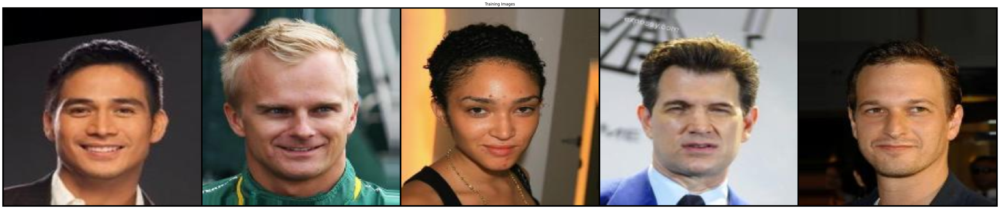

In [17]:
import torchvision.utils as vutils

real_batch,captions = next(iter(train_dataloader))
real_batch = real_batch[-5:]
captions = captions[-5:]
plt.figure(figsize=(56,56))
plt.axis("off")
plt.title("Training Images")
print(real_batch[0].shape)
print(real_batch[0].max())
print(real_batch[0].min())
print(captions)
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:32], padding=2, normalize=True).cpu(),(1,2,0)))


In [19]:
model = UNet2DConditionModel(
    sample_size=32,
    in_channels=4,
    out_channels=4,
    layers_per_block=2,
    block_out_channels=(64, 128, 256),
    down_block_types=(
        "DownBlock2D",
        "CrossAttnDownBlock2D",
        "CrossAttnDownBlock2D",

    ),

    up_block_types=(
        "CrossAttnUpBlock2D",
        "CrossAttnUpBlock2D",
        "UpBlock2D",
    ),
    cross_attention_dim=768
)
model = model.to(device)


model.load_state_dict(torch.load('/kaggle/working/unet_new.pth', weights_only=True))

<All keys matched successfully>

In [20]:
# sample_image = dataset[0]["images"].unsqueeze(0).to(device)
sample_image, captions =  next(iter(train_dataloader))
with torch.no_grad():
    print("Input shape", sample_image.shape)
    text_embeddings = get_text_embeddings(captions)
    print('Text embeddings shape',text_embeddings.size())
    image_latent_dist = get_image_latent_dist(sample_image.to(device)).to(device)
    print('Image latent dist shape',image_latent_dist.shape)
    print("Output shape", model(image_latent_dist, timestep=0,encoder_hidden_states=text_embeddings).sample.shape)

Input shape torch.Size([16, 3, 256, 256])
Text embeddings shape torch.Size([16, 27, 768])
Image latent dist shape torch.Size([16, 4, 32, 32])
Output shape torch.Size([16, 4, 32, 32])


In [21]:
import torch
import matplotlib.pyplot as plt
from tqdm import tqdm

def sample_image_generation(model, vae, noise_scheduler, captions, num_generate_images, guidance_scale=10):
    model.eval()
    with torch.no_grad():
        # Initialize noise
        noise = torch.randn(num_generate_images, 4, IMG_SIZE // 8, IMG_SIZE // 8).to(device)

        # Get conditioned text embeddings
        text_embeddings = get_text_embeddings(captions)

        # Denoising loop
        for t in tqdm(noise_scheduler.timesteps, position=0, leave=True):
            # Predict noise with conditioned text embeddings (guided)
            noise_pred_cond = model(noise, t, text_embeddings).sample

            # Predict noise without conditioning (unconditioned)
            null_embeddings = torch.zeros_like(text_embeddings).to(device)
            noise_pred_uncond = model(noise, t, null_embeddings).sample

            # Apply classifier-free guidance
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_cond - noise_pred_uncond)

            # Update the noise with the new prediction
            noise = noise_scheduler.step(noise_pred, t, noise).prev_sample

        # Decode the noise to generate images
        noise = noise / 0.18215  # Undo the latent scaling
        images = vae.decode(noise).sample

        # Print the captions
        for caption in captions:
            print(f'- {caption}')

        # Plot the generated images
        fig = plt.figure(figsize=(20, 20))
        for i in range(1, num_generate_images + 1):
            fig.add_subplot(4, 4, i)
            # Convert tensor to numpy for visualization
            img = images[i - 1].cpu().permute(1, 2, 0).numpy()
            img = (img + 1) / 2  # Rescale to [0, 1]
            plt.imshow(img)
            plt.axis('off')
        plt.show()


In [22]:
noise_scheduler = DDPMScheduler(num_train_timesteps=NUM_TIMESTEPS)
noise_scheduler.set_timesteps(num_inference_steps=40)

100%|██████████| 40/40 [00:02<00:00, 16.76it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


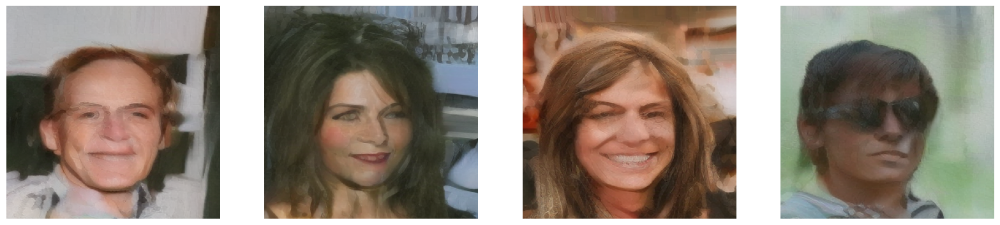

In [23]:
fixed_captions = (
'This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.',
 'There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.',
 'This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.',
 'This teen has short fringe, no mustache at all, no smile, and sunglasses.',
)

sample_image_generation(model,vae, noise_scheduler,fixed_captions, len(fixed_captions))



In [24]:
NUM_EPOCHS = 200
LEARNING_RATE =  1e-5
p_unconditional= 0.1

In [28]:
text_embdeddings_history = {}
image_latent_dist_history = {}

In [29]:
import copy

class EMAModel:
    def __init__(self, model, decay=0.999):
        self.ema_model = copy.deepcopy(model)  # Initialize EMA model as a copy of the original model
        self.decay = decay
        self.ema_has_been_updated = False  # Track if EMA has been applied at least once

    def update(self, model):
        for ema_param, model_param in zip(self.ema_model.parameters(), model.parameters()):
            ema_param.data.mul_(self.decay).add_(model_param.data, alpha=(1.0 - self.decay))
        self.ema_has_been_updated = True

    def apply(self, model):
        if not self.ema_has_been_updated:
            return model  # Use original model if EMA hasn't been updated yet
        return self.ema_model

# Initialize EMA
ema = EMAModel(model, decay=0.999)

# Update training loop to include EMA updates
optimizer = AdamW(model.parameters(), lr=LEARNING_RATE)

lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=500,
    num_training_steps=len(train_dataloader) * NUM_EPOCHS
)

accelerator = Accelerator(
    mixed_precision=MIXED_PRECISION,
    gradient_accumulation_steps=GRADIENT_ACCUMULATION_STEPS
)

model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(model, optimizer, train_dataloader, lr_scheduler)

Epoch [1/200] Loss: 0.1304: 100%|██████████| 560/560 [08:59<00:00,  1.04it/s]


------------------------------
Train Loss EPOCH: 1: 0.1304
Train Learning Rate EPOCH: 1: 9.9999928551615e-06


100%|██████████| 40/40 [00:03<00:00, 13.05it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


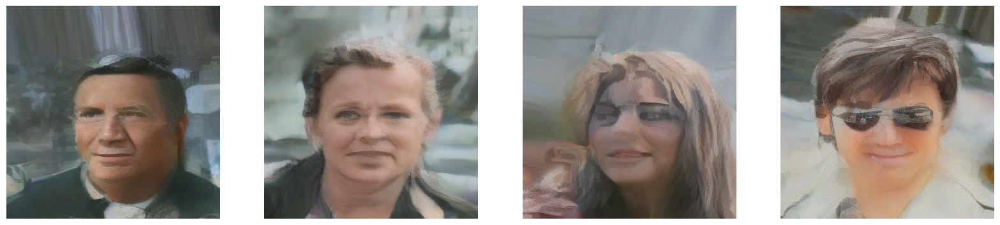

  0%|          | 1/200 [09:03<30:02:53, 543.59s/it]

------------------------------


Epoch [2/200] Loss: 0.1330: 100%|██████████| 560/560 [02:34<00:00,  3.63it/s]


------------------------------
Train Loss EPOCH: 2: 0.1330
Train Learning Rate EPOCH: 2: 9.999237109241448e-06


100%|██████████| 40/40 [00:03<00:00, 13.32it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


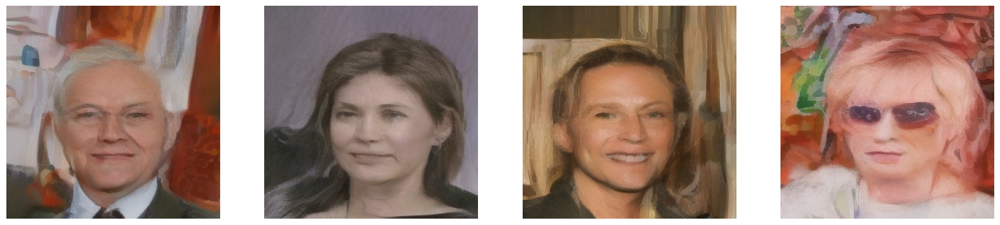

  1%|          | 2/200 [11:42<17:26:15, 317.05s/it]

------------------------------


Epoch [3/200] Loss: 0.1334: 100%|██████████| 560/560 [02:32<00:00,  3.66it/s]


------------------------------
Train Loss EPOCH: 3: 0.1334
Train Learning Rate EPOCH: 3: 9.997236789132487e-06


100%|██████████| 40/40 [00:03<00:00, 13.11it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


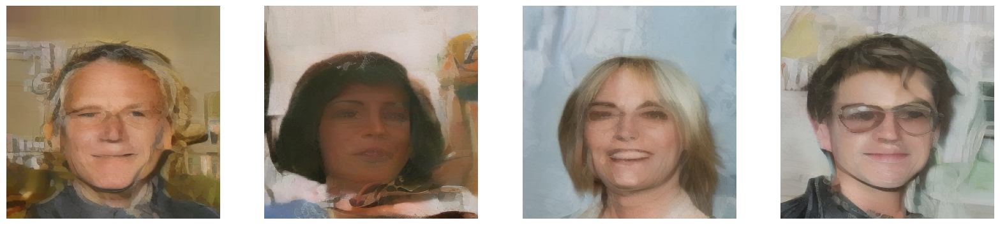

  2%|▏         | 3/200 [14:19<13:21:39, 244.16s/it]

------------------------------


Epoch [4/200] Loss: 0.1336: 100%|██████████| 560/560 [02:32<00:00,  3.66it/s]


------------------------------
Train Loss EPOCH: 4: 0.1336
Train Learning Rate EPOCH: 4: 9.993992392819957e-06


100%|██████████| 40/40 [00:02<00:00, 13.48it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


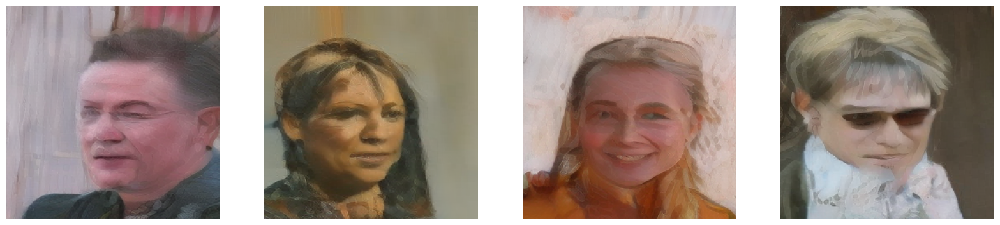

  2%|▏         | 4/200 [16:56<11:25:26, 209.83s/it]

------------------------------


Epoch [5/200] Loss: 0.1326: 100%|██████████| 560/560 [02:34<00:00,  3.63it/s]


------------------------------
Train Loss EPOCH: 5: 0.1326
Train Learning Rate EPOCH: 5: 9.989504728005474e-06


100%|██████████| 40/40 [00:03<00:00, 13.21it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


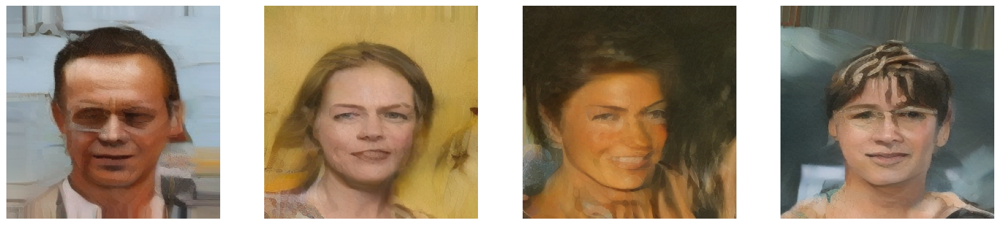

  2%|▎         | 5/200 [19:35<10:22:11, 191.44s/it]

------------------------------


Epoch [6/200] Loss: 0.1340: 100%|██████████| 560/560 [02:33<00:00,  3.64it/s]


------------------------------
Train Loss EPOCH: 6: 0.1340
Train Learning Rate EPOCH: 6: 9.983774911905865e-06


100%|██████████| 40/40 [00:03<00:00, 12.99it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


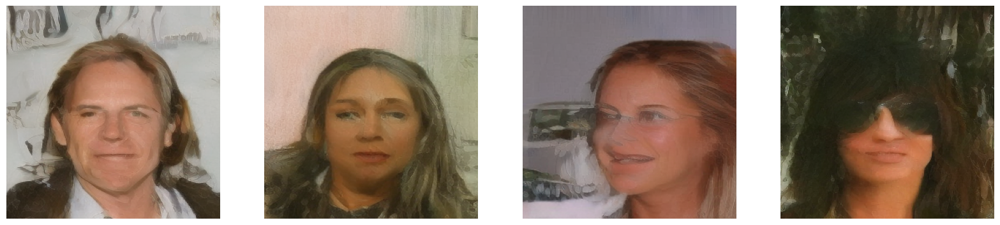

  3%|▎         | 6/200 [22:13<9:42:35, 180.18s/it] 

------------------------------


Epoch [7/200] Loss: 0.1330: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 7: 0.1330
Train Learning Rate EPOCH: 7: 9.976804370975017e-06


100%|██████████| 40/40 [00:03<00:00, 13.32it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


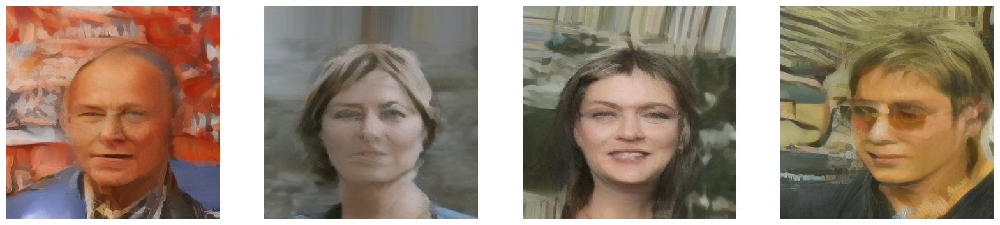

  4%|▎         | 7/200 [24:50<9:15:11, 172.60s/it]

------------------------------


Epoch [8/200] Loss: 0.1338: 100%|██████████| 560/560 [02:33<00:00,  3.65it/s]


------------------------------
Train Loss EPOCH: 8: 0.1338
Train Learning Rate EPOCH: 8: 9.96859484054877e-06


100%|██████████| 40/40 [00:03<00:00, 12.99it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


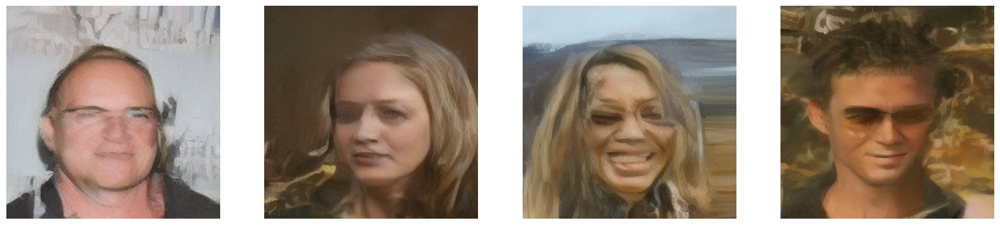

  4%|▍         | 8/200 [27:28<8:57:06, 167.85s/it]

------------------------------


Epoch [9/200] Loss: 0.1319: 100%|██████████| 560/560 [02:32<00:00,  3.66it/s]


------------------------------
Train Loss EPOCH: 9: 0.1319
Train Learning Rate EPOCH: 9: 9.959148364412894e-06


100%|██████████| 40/40 [00:03<00:00, 13.22it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


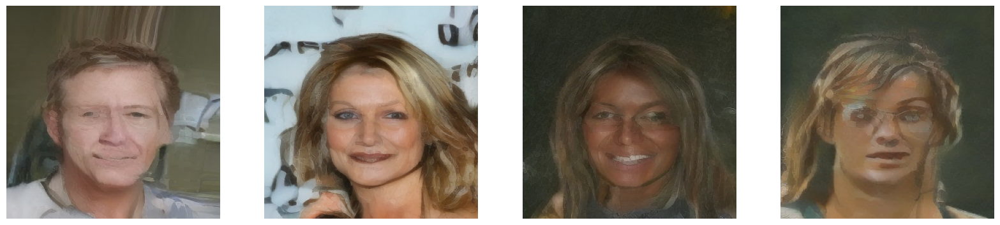

  4%|▍         | 9/200 [30:05<8:43:45, 164.53s/it]

------------------------------


Epoch [10/200] Loss: 0.1297: 100%|██████████| 560/560 [02:34<00:00,  3.62it/s]


------------------------------
Train Loss EPOCH: 10: 0.1297
Train Learning Rate EPOCH: 10: 9.948467294294289e-06


100%|██████████| 40/40 [00:03<00:00, 13.31it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


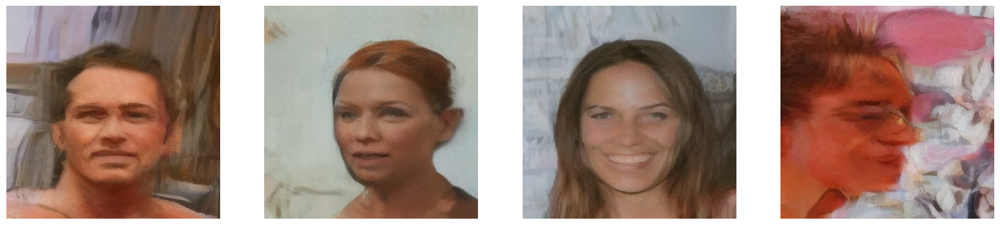

  5%|▌         | 10/200 [32:44<8:35:40, 162.84s/it]

------------------------------


Epoch [11/200] Loss: 0.1351: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 11: 0.1351
Train Learning Rate EPOCH: 11: 9.936554289275505e-06


100%|██████████| 40/40 [00:03<00:00, 13.13it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


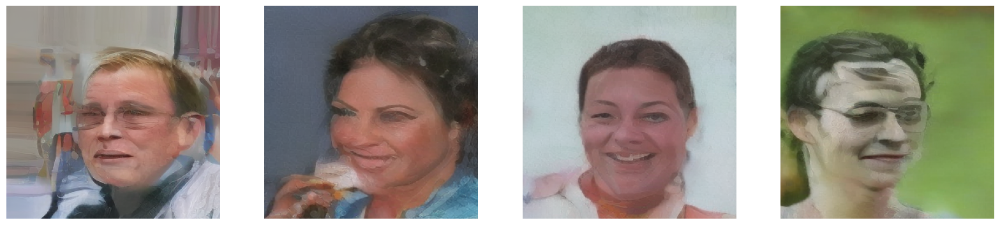

  6%|▌         | 11/200 [35:21<8:27:29, 161.11s/it]

------------------------------


Epoch [12/200] Loss: 0.1315: 100%|██████████| 560/560 [02:32<00:00,  3.68it/s]


------------------------------
Train Loss EPOCH: 12: 0.1315
Train Learning Rate EPOCH: 12: 9.923436876381322e-06


100%|██████████| 40/40 [00:02<00:00, 13.43it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


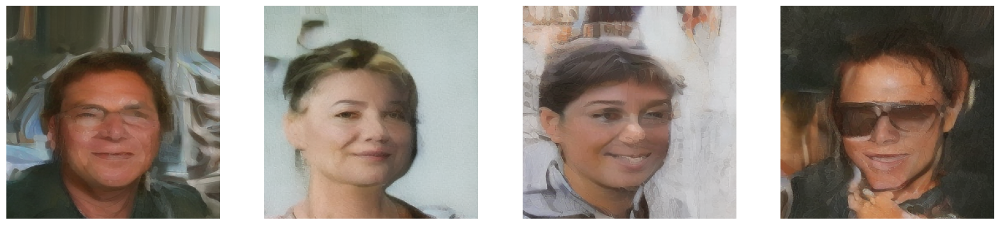

  6%|▌         | 12/200 [37:58<8:20:26, 159.72s/it]

------------------------------


Epoch [13/200] Loss: 0.1359: 100%|██████████| 560/560 [02:33<00:00,  3.66it/s]


------------------------------
Train Loss EPOCH: 13: 0.1359
Train Learning Rate EPOCH: 13: 9.90907139049429e-06


100%|██████████| 40/40 [00:03<00:00, 13.08it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


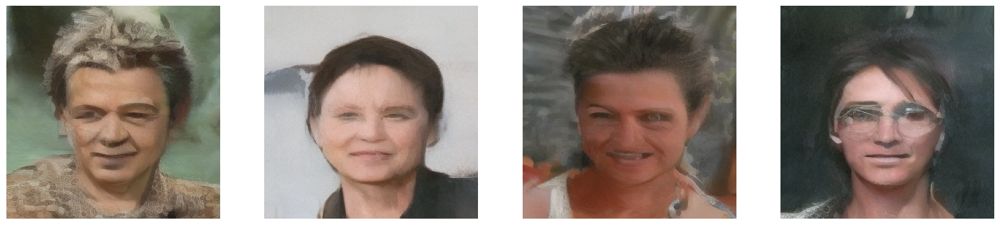

  6%|▋         | 13/200 [40:36<8:15:44, 159.06s/it]

------------------------------


Epoch [14/200] Loss: 0.1320: 100%|██████████| 560/560 [02:34<00:00,  3.64it/s]


------------------------------
Train Loss EPOCH: 14: 0.1320
Train Learning Rate EPOCH: 14: 9.89348377742853e-06


100%|██████████| 40/40 [00:03<00:00, 13.27it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


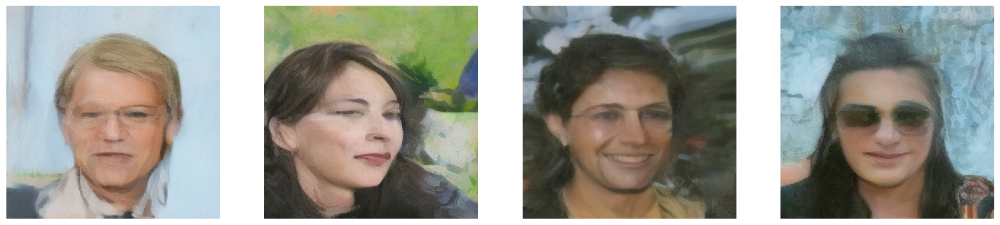

  7%|▋         | 14/200 [43:14<8:12:27, 158.86s/it]

------------------------------


Epoch [15/200] Loss: 0.1317: 100%|██████████| 560/560 [02:33<00:00,  3.64it/s]


------------------------------
Train Loss EPOCH: 15: 0.1317
Train Learning Rate EPOCH: 15: 9.87667791776431e-06


100%|██████████| 40/40 [00:02<00:00, 13.39it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


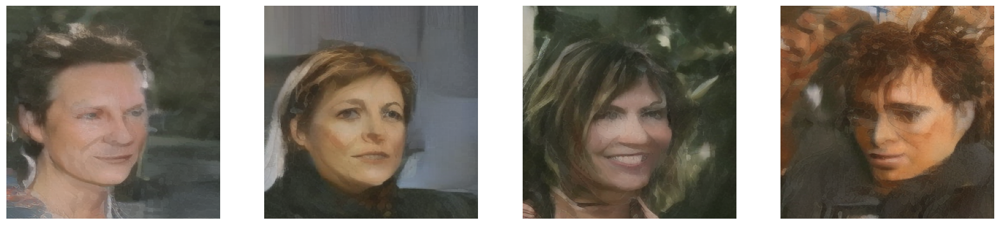

  8%|▊         | 15/200 [45:52<8:09:10, 158.65s/it]

------------------------------


Epoch [16/200] Loss: 0.1303: 100%|██████████| 560/560 [02:32<00:00,  3.68it/s]


------------------------------
Train Loss EPOCH: 16: 0.1303
Train Learning Rate EPOCH: 16: 9.85865799536783e-06


100%|██████████| 40/40 [00:03<00:00, 13.23it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


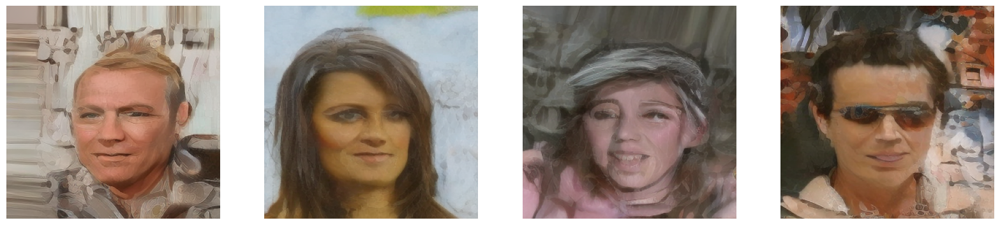

  8%|▊         | 16/200 [48:29<8:04:47, 158.08s/it]

------------------------------


Epoch [17/200] Loss: 0.1313: 100%|██████████| 560/560 [02:32<00:00,  3.68it/s]


------------------------------
Train Loss EPOCH: 17: 0.1313
Train Learning Rate EPOCH: 17: 9.839463909994075e-06


100%|██████████| 40/40 [00:03<00:00, 13.23it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


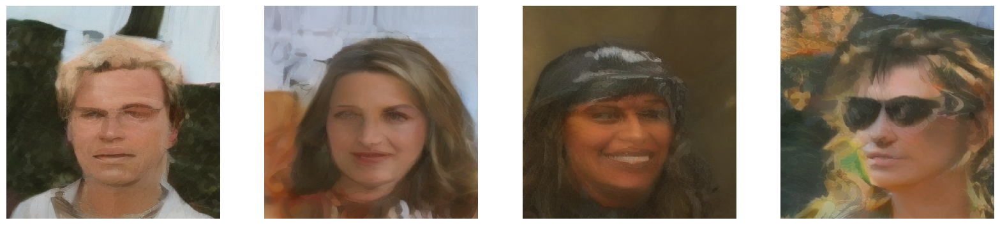

  8%|▊         | 17/200 [51:05<8:00:45, 157.63s/it]

------------------------------


Epoch [18/200] Loss: 0.1344: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 18: 0.1344
Train Learning Rate EPOCH: 18: 9.819031768556903e-06


100%|██████████| 40/40 [00:03<00:00, 13.33it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


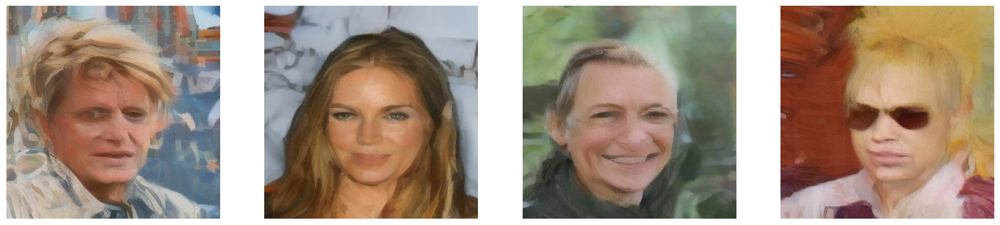

  9%|▉         | 18/200 [53:43<7:57:38, 157.46s/it]

------------------------------


Epoch [19/200] Loss: 0.1344: 100%|██████████| 560/560 [02:34<00:00,  3.63it/s]


------------------------------
Train Loss EPOCH: 19: 0.1344
Train Learning Rate EPOCH: 19: 9.797399915559023e-06


100%|██████████| 40/40 [00:03<00:00, 13.29it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


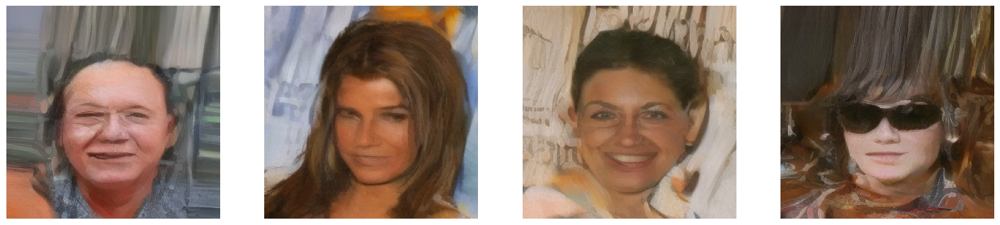

 10%|▉         | 19/200 [56:21<7:56:03, 157.81s/it]

------------------------------


Epoch [20/200] Loss: 0.1312: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 20: 0.1312
Train Learning Rate EPOCH: 20: 9.774573736311296e-06


100%|██████████| 40/40 [00:03<00:00, 13.18it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


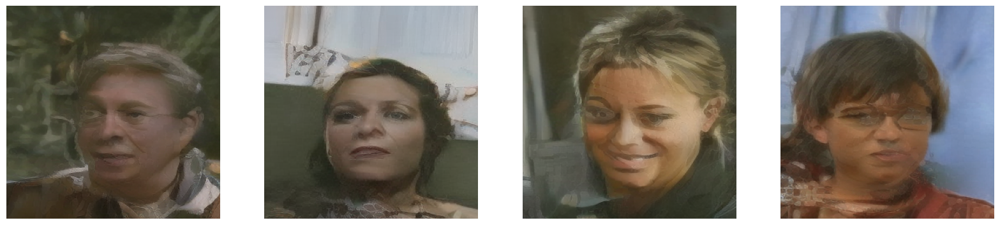

 10%|█         | 20/200 [58:58<7:52:39, 157.56s/it]

------------------------------


Epoch [21/200] Loss: 0.1329: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 21: 0.1329
Train Learning Rate EPOCH: 21: 9.750558913455477e-06


100%|██████████| 40/40 [00:03<00:00, 13.04it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


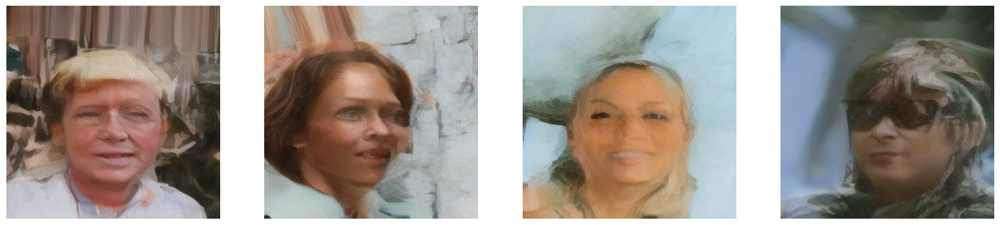

 10%|█         | 21/200 [1:01:35<7:49:36, 157.41s/it]

------------------------------


Epoch [22/200] Loss: 0.1299: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 22: 0.1299
Train Learning Rate EPOCH: 22: 9.725361425549495e-06


100%|██████████| 40/40 [00:03<00:00, 13.22it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


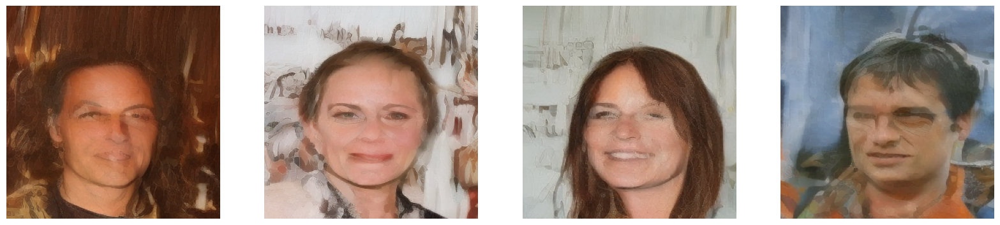

 11%|█         | 22/200 [1:04:12<7:46:41, 157.31s/it]

------------------------------


Epoch [23/200] Loss: 0.1282: 100%|██████████| 560/560 [02:33<00:00,  3.65it/s]


------------------------------
Train Loss EPOCH: 23: 0.1282
Train Learning Rate EPOCH: 23: 9.698987545579086e-06


100%|██████████| 40/40 [00:03<00:00, 13.26it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


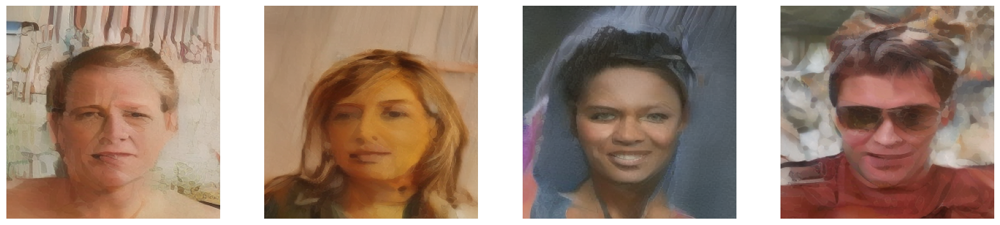

 12%|█▏        | 23/200 [1:06:50<7:44:38, 157.51s/it]

------------------------------


Epoch [28/200] Loss: 0.1290: 100%|██████████| 560/560 [02:31<00:00,  3.70it/s]


------------------------------
Train Loss EPOCH: 28: 0.1290
Train Learning Rate EPOCH: 28: 9.549829073543353e-06


100%|██████████| 40/40 [00:02<00:00, 13.63it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


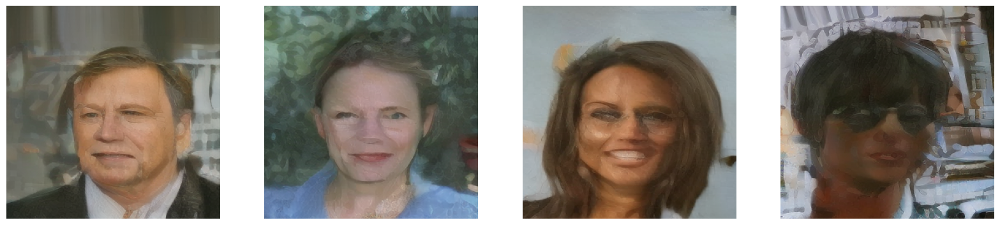

 14%|█▍        | 28/200 [1:19:52<7:27:45, 156.19s/it]

------------------------------


Epoch [29/200] Loss: 0.1320: 100%|██████████| 560/560 [02:33<00:00,  3.65it/s]


------------------------------
Train Loss EPOCH: 29: 0.1320
Train Learning Rate EPOCH: 29: 9.51654888657138e-06


100%|██████████| 40/40 [00:02<00:00, 13.37it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


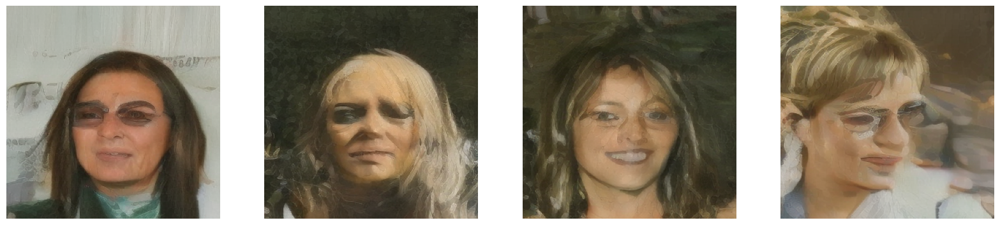

 14%|█▍        | 29/200 [1:22:29<7:26:21, 156.61s/it]

------------------------------


Epoch [30/200] Loss: 0.1317: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 30: 0.1317
Train Learning Rate EPOCH: 30: 9.482144292005944e-06


100%|██████████| 40/40 [00:02<00:00, 13.53it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


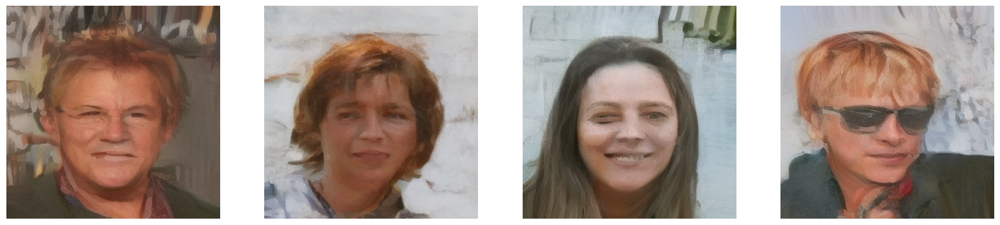

 15%|█▌        | 30/200 [1:25:06<7:23:54, 156.67s/it]

------------------------------


Epoch [31/200] Loss: 0.1308: 100%|██████████| 560/560 [02:31<00:00,  3.69it/s]


------------------------------
Train Loss EPOCH: 31: 0.1308
Train Learning Rate EPOCH: 31: 9.446623854967965e-06


100%|██████████| 40/40 [00:02<00:00, 13.59it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


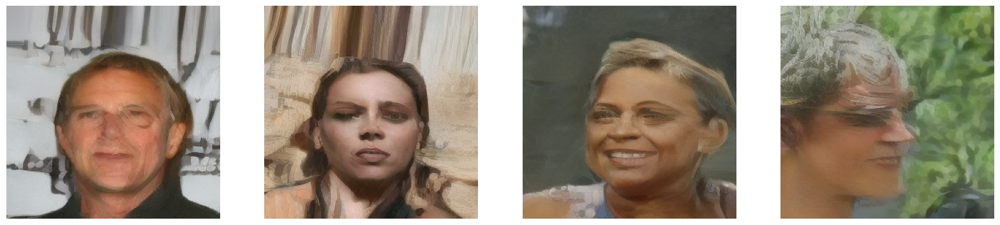

 16%|█▌        | 31/200 [1:27:42<7:20:45, 156.48s/it]

------------------------------


Epoch [32/200] Loss: 0.1327: 100%|██████████| 560/560 [02:32<00:00,  3.67it/s]


------------------------------
Train Loss EPOCH: 32: 0.1327
Train Learning Rate EPOCH: 32: 9.409996418370507e-06


100%|██████████| 40/40 [00:02<00:00, 13.34it/s]


- This person in his forties has no beard at all, no eyeglasses, and no fringe. This corners of his mouth curve up and we can see some teeth.
- There is not any glasses on the face and has no smile, and no bangs. This female is in the thirties.
- This person is smiling with the mouth only a little open and has no bangs, and no eyeglasses. This lady is a teen.
- This teen has short fringe, no mustache at all, no smile, and sunglasses.


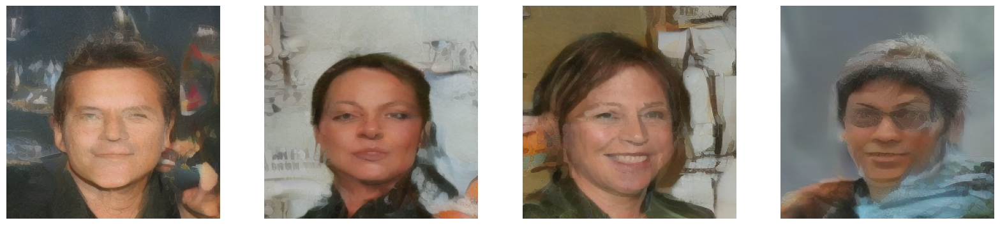

 16%|█▌        | 32/200 [1:30:19<7:18:34, 156.63s/it]

------------------------------


Epoch [33/200] Loss: 0.1302:  77%|███████▋  | 430/560 [01:58<00:35,  3.66it/s]

In [ ]:
start = timeit.default_timer()

guidance_scale = 10  # Hyperparameter controlling guidance strength

for epoch in tqdm(range(NUM_EPOCHS), position=0, leave=True):
    model.train()
    train_running_loss = 0
    total_batches = len(train_dataloader)
    progress_bar = tqdm(train_dataloader, position=0, leave=True)

    for idx, (images, captions) in enumerate(progress_bar):
        images = images.to(device)

        # Get text embeddings for conditional generation
        if idx in text_embdeddings_history:
            text_embeddings = text_embdeddings_history[idx].to(device)
        else:
            text_embeddings = get_text_embeddings(captions).to(device)
            text_embdeddings_history[idx] = text_embeddings.cpu()

        # Generate unconditional text embeddings (null condition)
        unconditional_embeddings = torch.zeros_like(text_embeddings).to(device)

        # Get latent distribution for images
        if idx in image_latent_dist_history:
            image_latent_dist = image_latent_dist_history[idx].to(device)
        else:
            image_latent_dist = get_image_latent_dist(images).to(device)
            image_latent_dist = image_latent_dist * 0.18215  # Scale factor for latent distribution
            image_latent_dist_history[idx] = image_latent_dist.cpu()

        # Generate noise and timesteps
        noise = torch.randn(image_latent_dist.shape).to(device)
        last_batch_size = len(noise)
        timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (last_batch_size,)).to(device)
        noisy_image_latent_dist = noise_scheduler.add_noise(image_latent_dist, noise, timesteps)

        with accelerator.accumulate(model):
            # Forward pass with conditional text embeddings (guided)
            noise_pred_conditional = model(noisy_image_latent_dist, timesteps, text_embeddings, return_dict=False)[0]

            # Forward pass with unconditional embeddings (unguided)
            noise_pred_unconditional = model(noisy_image_latent_dist, timesteps, unconditional_embeddings, return_dict=False)[0]

            # Apply classifier-free guidance
            noise_pred = noise_pred_unconditional + guidance_scale * (noise_pred_conditional - noise_pred_unconditional)

            # Calculate the loss between the predicted noise and the true noise
            loss = F.mse_loss(noise_pred, noise)

            # Backpropagation and optimization
            accelerator.backward(loss)
            accelerator.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()
            lr_scheduler.step()
            optimizer.zero_grad()

        # Update Exponential Moving Average (EMA)
        ema.update(model)

        # Update running loss and progress bar
        train_running_loss += loss.item()
        avg_loss = train_running_loss / (idx + 1)
        progress_bar.set_description(f"Epoch [{epoch+1}/{NUM_EPOCHS}] Loss: {avg_loss:.4f}")

    # Log training loss and learning rate
    train_loss = train_running_loss / total_batches
    train_learning_rate = lr_scheduler.get_last_lr()[0]

    print("-" * 30)
    print(f"Train Loss EPOCH: {epoch+1}: {train_loss:.4f}")
    print(f"Train Learning Rate EPOCH: {epoch+1}: {train_learning_rate}")

    # Use EMA model for evaluation and image generation
    if epoch % 1 == 0:
        sample_image_generation(ema.apply(model), vae, noise_scheduler, fixed_captions, len(fixed_captions))
        torch.save(ema.apply(model).state_dict(), '/kaggle/working/unet_new.pth')

    print("-" * 30)

stop = timeit.default_timer()
print(f"Training Time: {stop-start:.2f}s")
